<a href="https://colab.research.google.com/github/IYashCanCode/Detectron2-Mask-Detection/blob/main/Detectron2_Mask_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1><b>Mask Segmentation Using Detectron - 2<br>

<br> Project Group : 4 <br>
<br> By:<br>
Neha Chaudhary <br>
Yash Kumar

<b><h1> Installing and loading necessary modules

In [ ]:
!git clone https://github.com/facebookresearch/detectron2.git

Cloning into 'detectron2'...
remote: Enumerating objects: 15297, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (21/21), done.
remote: Total 15297 (delta 7), reused 7 (delta 1), pack-reused 15275
Receiving objects: 100% (15297/15297), 6.18 MiB | 2.44 MiB/s, done.
Resolving deltas: 100% (11118/11118), done.


In [ ]:
!git clone https://github.com/IYashCanCode/Detectron2-Mask-Detection.git

Cloning into 'Detectron2-Mask-Detection'...
remote: Enumerating objects: 461, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (16/16), done.
remote: Total 461 (delta 6), reused 21 (delta 6), pack-reused 439
Receiving objects: 100% (461/461), 90.43 MiB | 20.01 MiB/s, done.
Resolving deltas: 100% (33/33), done.


In [ ]:
!pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-vcds3w3t
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-vcds3w3t
  Resolved https://github.com/facebookresearch/detectron2.git to commit e9f7e2ba15abd7badcb05ef6f5076f06b36a9c5b
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 19.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 17.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=6119645 sha256=c6fecf0557ad9ee48efc70630a29

In [ ]:
from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.config import get_cfg
from detectron2.solver import build_optimizer
from detectron2.utils.visualizer import ColorMode, Visualizer
from detectron2.structures import BoxMode
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data import build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset, LVISEvaluator
from detectron2.utils.logger import setup_logger
setup_logger()

import os
import cv2
import pickle
import random
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

<h3><b>Registering Training images coco format

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("OD_Mask_train", {}, "/content/Detectron2-Mask-Detection/sample_train/train_.json", "/content/Detectron2-Mask-Detection/sample_train/images")
register_coco_instances("OD_Mask_test", {}, "/content/Detectron2-Mask-Detection/sample_test/test_images.json", "/content/Detectron2-Mask-Detection/sample_test/images")

In [ ]:
OD_Mask_metadata_train = MetadataCatalog.get("OD_Mask_train")
OD_Mask_metadata_test = MetadataCatalog.get("OD_Mask_test")
dataset_dicts_train = DatasetCatalog.get("OD_Mask_train")
dataset_dicts_test = DatasetCatalog.get("OD_Mask_test")

WARNING [01/04 11:53:19 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[01/04 11:53:19 d2.data.datasets.coco]: Loaded 337 images in COCO format from /content/Detectron2-Mask-Detection/sample_train/train_.json
WARNING [01/04 11:53:19 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[01/04 11:53:19 d2.data.datasets.coco]: Loaded 22 images in COCO format from /content/Detectron2-Mask-Detection/sample_test/test_images.json


<h3><b>Visualizing training images

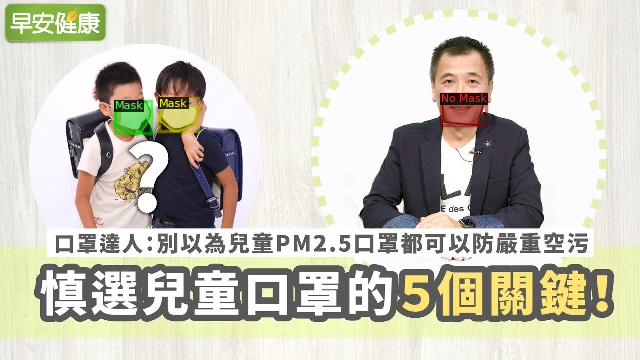

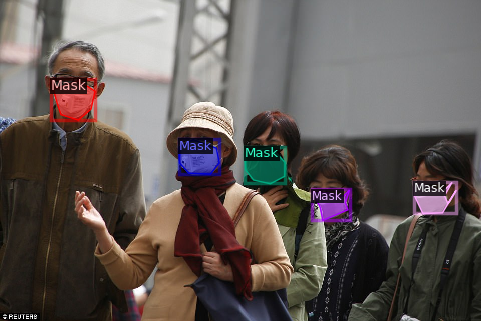

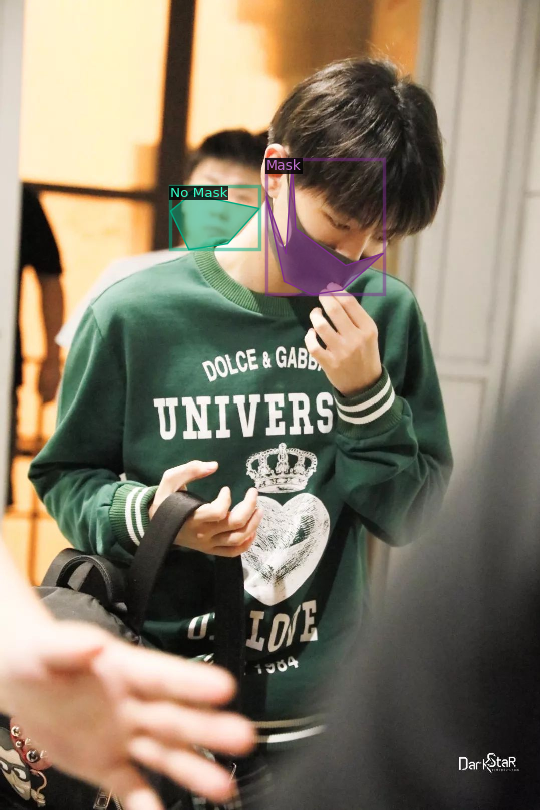

In [ ]:
import random

for d in random.sample(dataset_dicts_train, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=OD_Mask_metadata_train, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

<h3><b>Visualizing testing images

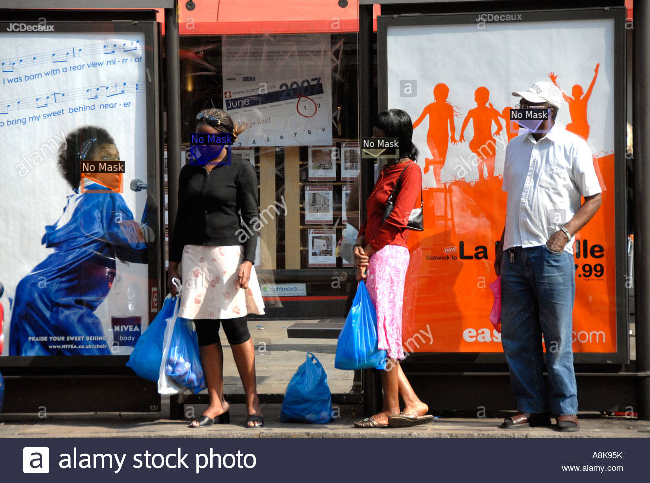

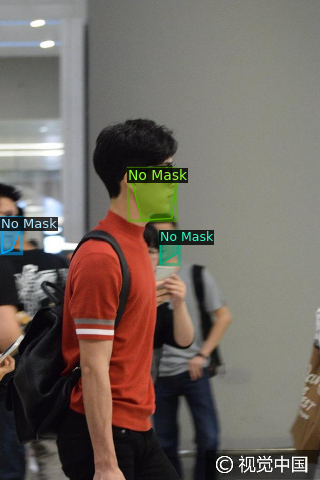

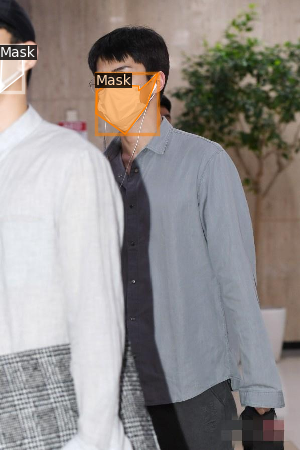

In [ ]:
import random

for d in random.sample(dataset_dicts_test, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=OD_Mask_metadata_test, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

<h3><b>Training Detectron2 detection model on custome dataset of mask detection

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml'))
cfg.DATASETS.TRAIN = ("OD_Mask_train",)
cfg.DATASETS.TEST = ("OD_Mask_test",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url('COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml')
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.LR_SCHEDULER_NAME = 'WarmupMultiStepLR'
cfg.MODEL.DEVICE='cuda'
cfg.SOLVER.GAMMA = 0.2
cfg.SOLVER.STEPS = []
cfg.SOLVER.MAX_ITER = 500
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.IOU_THRESHOLDS = [0.8]
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[01/04 11:53:23 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:01, 201MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[01/04 11:53:25 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[01/04 11:53:43 d2.utils.events]:  eta: 0:05:40  iter: 19  total_loss: 1.85  loss_cls: 0.995  loss_box_reg: 0.007166  loss_mask: 0.6898  loss_rpn_cls: 0.1111  loss_rpn_loc: 0.0234    time: 0.7344  last_time: 0.7358  data_time: 0.0311  last_data_time: 0.0262   lr: 3.8962e-05  max_mem: 3650M
[01/04 11:54:05 d2.utils.events]:  eta: 0:05:26  iter: 39  total_loss: 1.373  loss_cls: 0.5593  loss_box_reg: 0.006736  loss_mask: 0.6565  loss_rpn_cls: 0.09257  loss_rpn_loc: 0.026    time: 0.7266  last_time: 0.6902  data_time: 0.0326  last_data_time: 0.0225   lr: 7.8922e-05  max_mem: 3650M
[01/04 11:54:18 d2.utils.events]:  eta: 0:05:02  iter: 59  total_loss: 0.9372  loss_cls: 0.2316  loss_box_reg: 0.01181  loss_mask: 0.5738  loss_rpn_cls: 0.06457  loss_rpn_loc: 0.0179    time: 0.7004  last_time: 0.7274  data_time: 0.0123  last_data_time: 0.0056   lr: 0.00011888  max_mem: 3650M
[01/04 11:54:32 d2.utils.events]:  eta: 0:04:49  iter: 79  total_loss: 0.7627  loss_cls: 0.1847  loss_box_reg: 0.02086  lo

In [ ]:
import json
import pandas as pd

# Load the JSON file
with open('/content/output/metrics.json', 'r') as f:
    data = f.readlines()

# Parse each line of JSON and create a list of dictionaries
parsed_data = []
for line in data:
    parsed_data.append(json.loads(line))

# Convert the list of dictionaries to a Pandas DataFrame
df = pd.DataFrame(parsed_data)

# Extract the required columns
df = df[['total_loss', 'loss_box_reg', 'loss_cls', 'loss_mask', 'loss_rpn_cls', 'loss_rpn_loc', 'iteration']]

# Set the figure size


# Set the x and y limits


# Plot the curves
plt.plot(df['iteration'], df['total_loss'], label='Total Loss')


# Add labels and legend
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.legend()

# Show the plot
plt.show()


<h3><b>Joining custom weights to the detectron model

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.75
cfg.DATASETS.TEST = ("OD_Mask_test", )
predictor = DefaultPredictor(cfg)

[01/04 11:59:37 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

<h3><b>Predicting the images using custom mask detection detectron2 model

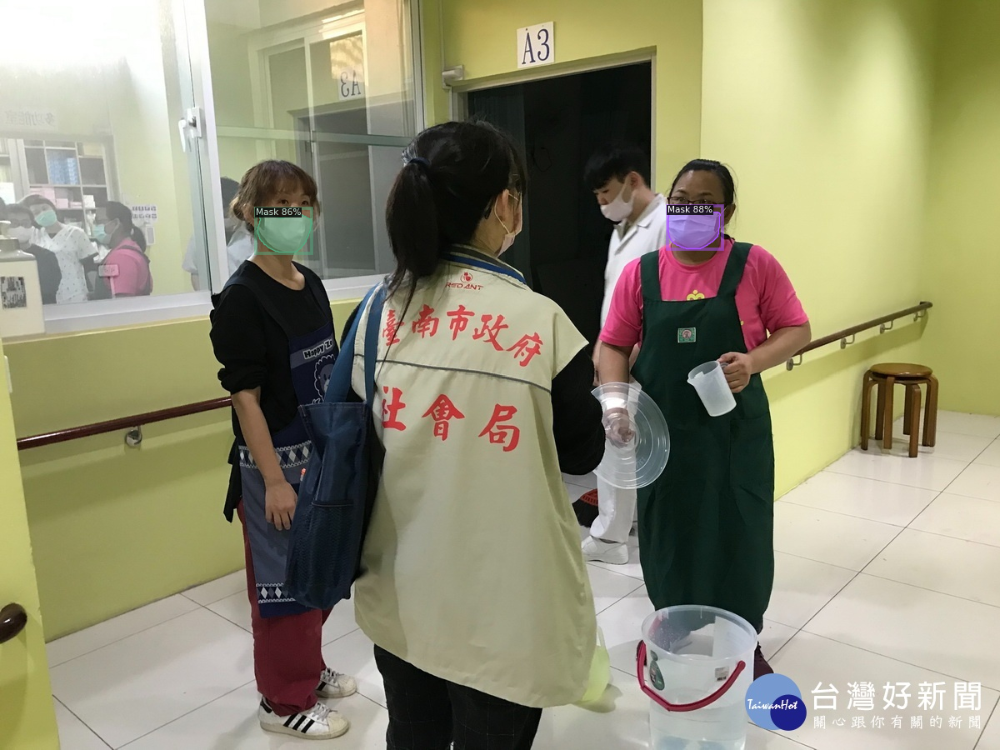

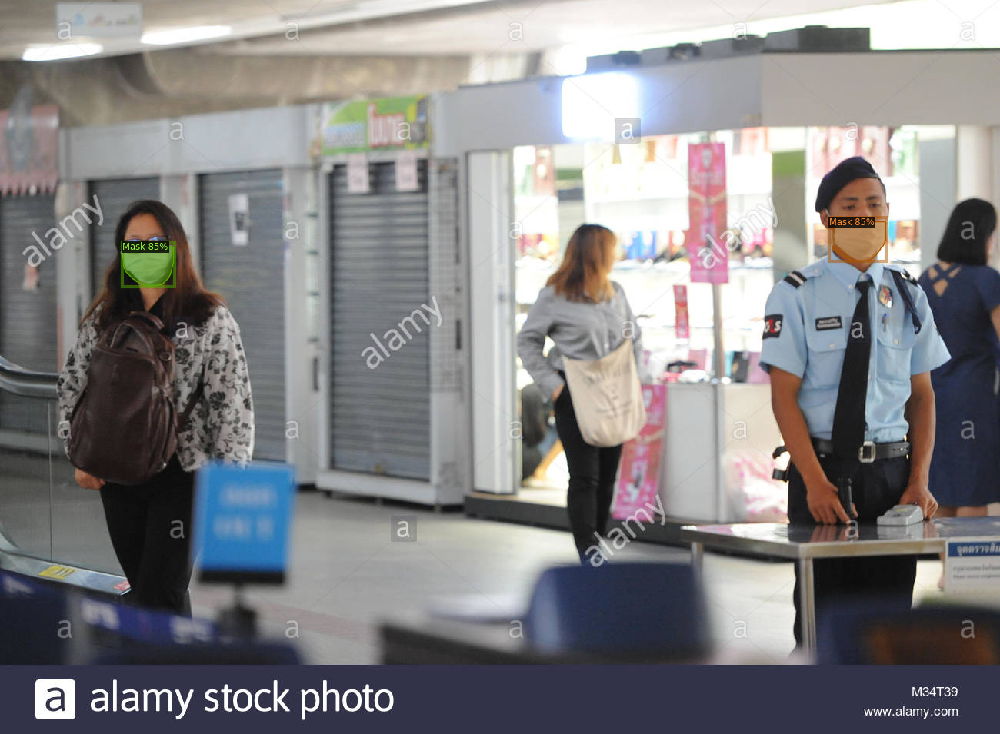

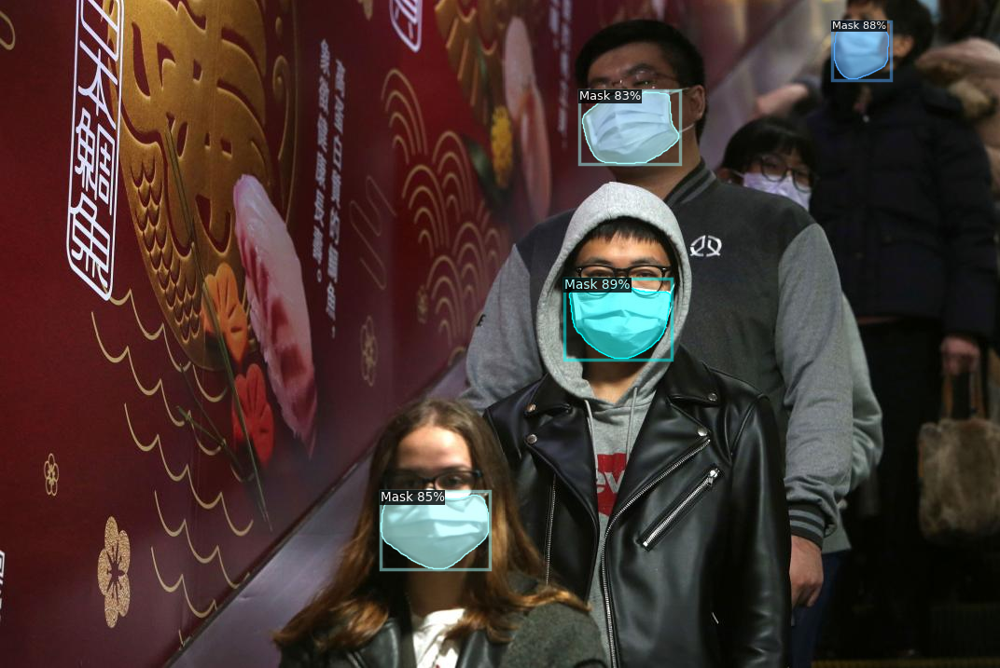

In [ ]:
for d in random.sample(dataset_dicts_train, 3):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=OD_Mask_metadata_train,
                   scale=1.,
                   instance_mode=ColorMode.IMAGE
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

<h3><b>Predicting new unseen images from custom mask detection detectron2 model

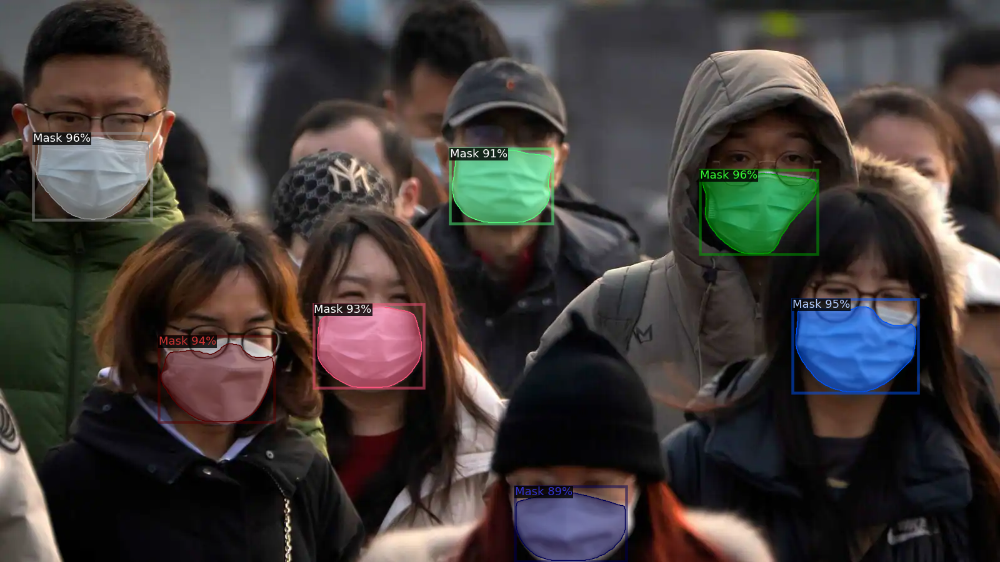

In [ ]:
im = cv2.imread('/content/Detectron2-Mask-Detection/unseen_test_images/face_masks_1676434071914_1676434072173_1676434072173.jpg')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata=OD_Mask_metadata_train,
                scale=1.,
                instance_mode=ColorMode.IMAGE
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

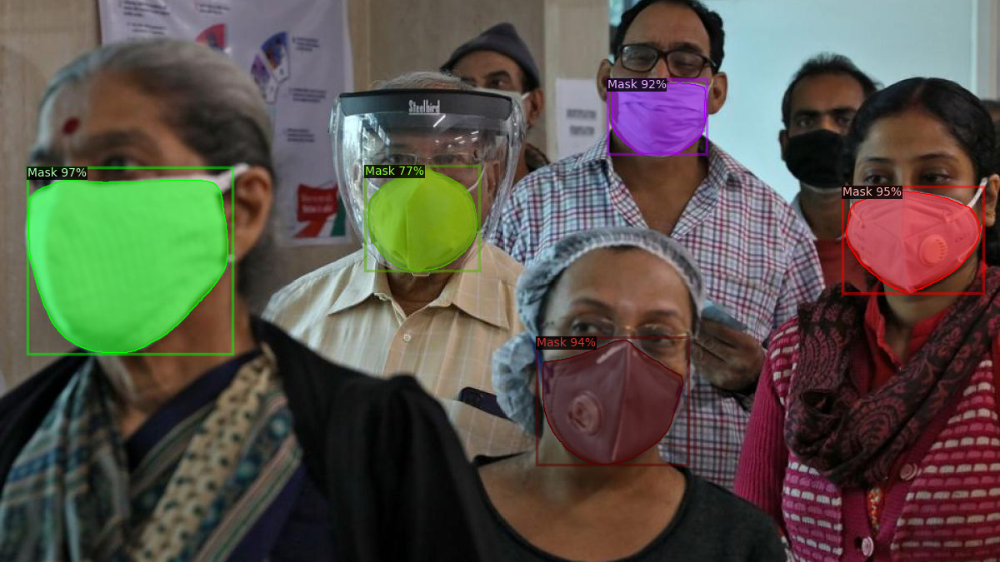

In [ ]:
im = cv2.imread('/content/Detectron2-Mask-Detection/unseen_test_images/covid_masks-sixteen_nine.jpeg')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata=OD_Mask_metadata_train,
                scale=1.,
                instance_mode=ColorMode.IMAGE
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

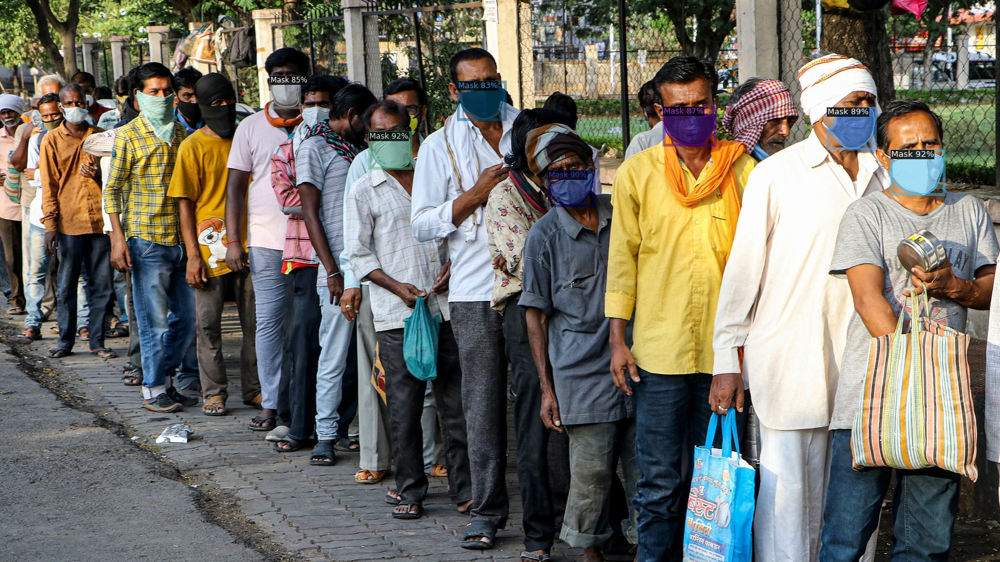

In [ ]:
im = cv2.imread('/content/Detectron2-Mask-Detection/unseen_test_images/PTI05_17_2021_000164A_1621562268101_1621562291587.jpg')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata=OD_Mask_metadata_train,
                scale=1.,
                instance_mode=ColorMode.IMAGE
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

<h3><b>Evaluting the model performance using COCOEvaluator

In [ ]:
evaluator = COCOEvaluator("OD_Mask_train", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "OD_Mask_train")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [01/04 11:59:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [01/04 11:59:49 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[01/04 11:59:49 d2.data.datasets.coco]: Loaded 337 images in COCO format from /content/Detectron2-Mask-Detection/sample_train/train_.json
[01/04 11:59:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/04 11:59:49 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[01/04 11:59:49 d2.data.common]: Serializing 337 elements to byte tensors and concatenating them all ...
[01/04 11:59:49 d2.data.common]: Serialized dataset takes 0.28 MiB
[01/04 11:59:49 d2.evaluation.evaluator]: Start inference on 337 batches
[01/04 11:59

OrderedDict([('bbox',
              {'AP': 33.450357886721335,
               'AP50': 71.16402487248332,
               'AP75': 27.014392565324062,
               'APs': 21.79189224904116,
               'APm': 34.466490861786866,
               'APl': 35.6186939464502,
               'AP-Mask': 48.5591879235431,
               'AP-No Mask': 18.341527849899574}),
             ('segm',
              {'AP': 35.207199716632914,
               'AP50': 71.37284320821477,
               'AP75': 32.57665031661493,
               'APs': 18.282388033862755,
               'APm': 36.18457293673514,
               'APl': 40.651874615024546,
               'AP-Mask': 53.46458654771773,
               'AP-No Mask': 16.949812885548084})])

In [ ]:
evaluator = COCOEvaluator("OD_Mask_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "OD_Mask_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [01/04 12:01:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [01/04 12:01:05 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[01/04 12:01:05 d2.data.datasets.coco]: Loaded 22 images in COCO format from /content/Detectron2-Mask-Detection/sample_test/test_images.json
[01/04 12:01:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/04 12:01:05 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[01/04 12:01:05 d2.data.common]: Serializing 22 elements to byte tensors and concatenating them all ...
[01/04 12:01:05 d2.data.common]: Serialized dataset takes 0.02 MiB
[01/04 12:01:05 d2.evaluation.evaluator]: Start inference on 22 batches
[01/04 12:0

OrderedDict([('bbox',
              {'AP': 28.297947751617514,
               'AP50': 69.48374475486968,
               'AP75': 21.824491793969944,
               'APs': 25.953456544046805,
               'APm': 33.3545437877121,
               'APl': 23.40611080338803,
               'AP-Mask': 39.76636278560802,
               'AP-No Mask': 16.829532717626993}),
             ('segm',
              {'AP': 35.04148014502601,
               'AP50': 70.41208015637892,
               'AP75': 31.96797554861971,
               'APs': 24.2897217714831,
               'APm': 36.61543538969282,
               'APl': 43.14016695787226,
               'AP-Mask': 54.017818544943054,
               'AP-No Mask': 16.065141745108992})])